## Load dependencies
Takes 1-2min


## References
Fourier Neural Operators: [ArXiv](https://arxiv.org/abs/2010.08895)

`neuraloperator` documentation and examples: [reference](https://neuraloperator.github.io/neuraloperator/dev/user_guide/neural_operators.html)

In [ ]:
!pip install -U neuraloperator
!pip install wandb
!pip install torch-harmonics

In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader

from tqdm import tqdm
import sys
import sympy as sp
import numpy as np
from scipy import integrate
from scipy.integrate import quad

import neuralop
from neuralop.models import TFNO, FNO
from neuralop import LpLoss, H1Loss
from neuralop.utils import count_model_params, UnitGaussianNormalizer
from neuralop.datasets import load_darcy_flow_small, load_navier_stokes_pt
from neuralop.training.callbacks import CheckpointCallback, BasicLoggerCallback
from neuralop.training import Trainer
from neuralop.datasets.data_transforms import DefaultDataProcessor
from scipy.interpolate import interp1d

from IPython.display import HTML
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# (1.) Heat Equation
Find solution $u: \Omega \times I \rightarrow \mathbb{R}$ to
$$\frac{\partial u}{\partial t} = \alpha \Delta u$$

on some $\Omega \subseteq \mathbb{R}^{d}$. In particular, we can enforce the initial condition through a function $g$ for $d=1$ and $\alpha=1$. We have the initial value problem (IVP)
\begin{align*}
\frac{\partial u}{\partial t} &= \frac{\partial^{2}}{\partial x^{2}} u \mbox{,} \qquad (x,t) \in \Omega \times [0,\infty) \mbox{,} \\
                         u(\cdot, x) &= \delta_{0}(x) \mbox{,} \; \; \quad \qquad x \in \Omega \mbox{.}
\end{align*}

with the analytic solution
$u(x,t) = \int \Phi(x - y, t) g(y) \mbox{d}y$ with $\Phi(x,t) = \frac{1}{\sqrt{4 \pi t}} \exp \left( - \frac{x^{2}}{4 t} \right)$. 

## (1.1) Pseudo-numerical solver
Analytic solution enables exact computation of groundtruth reference for noise-free measurements.

In [2]:
def u_hat_x(t:float):
    """Computes u(x,t) for a given grix `x` at time `t`, i.e. x ↦ u(t,)
       Pseudo-numerical solver
    """
    
    # variables
    x, y, t_arg  = sp.symbols('x y t', real=True)
    t_arg = sp.symbols('t', real=True, positive=True)

    # symbolic function represenations
    # - heat kernel 
    K = (1 / sp.sqrt(4 * sp.pi * t_arg)) * sp.exp(-x**2 / (4 * t_arg)) 
    # - initial value function (smooth approximation of δ_{0}(y))
    g = sp.exp(-y**2 / 0.001)  
    
    # t=0 -> return IC
    if np.isclose(t,0):
        return sp.lambdify(y, g, 'numpy')
    
    # insert time `t`
    K_t = K.subs(t_arg, t)
    
    # numeric function representations
    K_numeric = sp.lambdify((x, y), K_t.subs(x, x-y), 'numpy')
    g_numeric = sp.lambdify(y, g, 'numpy')
    
    def integrand(y, x):
        """Inner function: SciPy inetegration routine required integrand to be a function of (x,y)  
        """
        return K_numeric(x, y) * g_numeric(y)
    
    def u_x_numeric(x_value):
        """Inner function: convolution of g with (heat) kernel K
        """
        # Integrate from -inf to +inf, with x_value as an additional parameter
        result, _ = integrate.quad(integrand, -np.inf, np.inf, args=(x_value,))
        return result
    
    # u(x,t)
    return u_x_numeric

## (1.2) Generate noisy observations from the system
Noise emulates measurement error or discretiziation error for a numerical solver providing sample datapoints.

In [3]:
# INPUTS
# - temporal range [0,T)
T = 1

# discretization
# - n_nodes : number of spatial grid points on [-2,2]
# - N_grid  : discretization of [-2,2] for subsequent super-resolution inference
# - t_nodes : number of temporal grid points [0,T)
n_nodes, N_grid, t_nodes = 64, 50, 200

In [4]:
# time index
T_index = np.logspace(-2, np.log(T)+1, t_nodes)

# space index
s_max = 2
x_nodes      = np.concatenate((np.linspace(-1 * s_max, 0, n_nodes // 2, endpoint=False), np.linspace(0, s_max, n_nodes // 2)))
x_nodes_eval = np.concatenate((np.linspace(-1 * s_max, 0, n_nodes * 2, endpoint=False), np.linspace(0, s_max, n_nodes * 2)))

# numerical grid (for simplicity identical to nodes)
x_grid       = x_nodes # np.linspace(-s_max, s_max, N_grid)
x_grid_eval  = x_nodes_eval

# grid
G      = np.empty((len(T_index), len(x_grid)))
G_eval = np.empty((len(T_index), len(x_nodes_eval)))

# assign by time
for i,t in tqdm(enumerate(T_index), total=len(T_index)):
    # vectorized mapping u(⋅,t)
    u_dot_t = np.vectorize(u_hat_x(t))
    
    # apply u(⋅,t) to node points
    u_vals = u_dot_t(x_nodes)
    
    # interpolate on refined grid
    u_dot_interpol = interp1d(x_nodes, u_vals, kind='linear')
    
    # assign interpolated func values to G(t,⋅)
    # - train
    G[i,:] = u_dot_interpol(x_grid)
    # - eval
    G_eval[i,:] = u_dot_interpol(x_grid_eval)

# evaluation grid
# - for inference
T_index_tensor = torch.tensor(T_index[:, np.newaxis, np.newaxis], dtype=torch.float32)  # Shape: [r, 1, 1]
x_grid_tensor = torch.tensor(np.repeat(x_nodes, len(x_nodes)).reshape(len(x_nodes), -1), dtype=torch.float32).unsqueeze(0)  # Shape: [1, 200]

# broadcasting to combine T_index and x_grid into a 3D tensor
x_t_eval = T_index_tensor + x_grid_tensor  

100%|██████████| 200/200 [00:08<00:00, 24.57it/s]


## (1.3) Visualize system dynamics
Visualize the graphs (of the interpolated, noise-free function values).

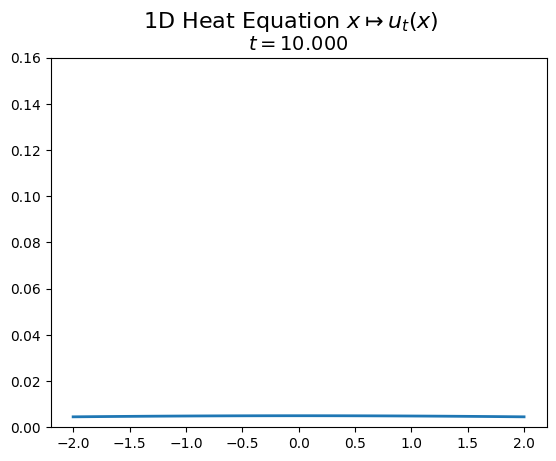

In [5]:
# figure & axis for the plot
fig, ax = plt.subplots()
line, = ax.plot(x_grid, G[0, :], linewidth=2)  # Initial plot
ax.set_ylim(0, 0.16)  # Set the y-axis limits

fig.suptitle("1D Heat Equation $x \mapsto u_{t}(x)$", fontsize=16)
title = ax.set_title(f"$t = 0$", fontsize=14)

# update function for the animation
def update(i):
    line.set_ydata(G[i, :])  # Update the y-data of the plot
    title.set_text(f"$t = {T_index[i]:.3f}$")
    return line,

# create the animation
ani = FuncAnimation(fig, update, frames=range(G.shape[0]), blit=True, interval=80)

# display the animation in a Jupyter notebook
HTML(ani.to_jshtml())

## (1.4) Visualize noisy datapoints
Grey: the actual law, the noisy measurements in $\color{red}{red}$.

In [6]:
# samples
n_sample_per_t   = len(x_grid) # i.e. all points
eps_sigma        = 1E-3

# sample 
np.random.seed(12345)
# - deterministic grid, for simplicity
rnd_index        = [range(len(row)) for row in G] #[np.random.choice(range(len(row)), n_sample_per_t, replace=False) for row in G]
sampled_x_grid   = np.array([x_grid[rowd_idx] for rowd_idx in rnd_index])
sampled_G_vals   = np.array([G[i,rowd_idx] for i,rowd_idx in enumerate(rnd_index)])
# - eval
eval_rnd_index   = [range(len(row)) for row in G_eval]
samp_x_grid_eval = np.array([x_grid_eval[rowd_idx] for rowd_idx in eval_rnd_index]) # x_grid_eval 
samp_G_vals_eval = np.array([G_eval[i,rowd_idx] for i,rowd_idx in enumerate(eval_rnd_index)])

# simulate noisy measurement
sampled_G_vals   = np.random.normal(sampled_G_vals, scale=eps_sigma)
# - no noise on eval

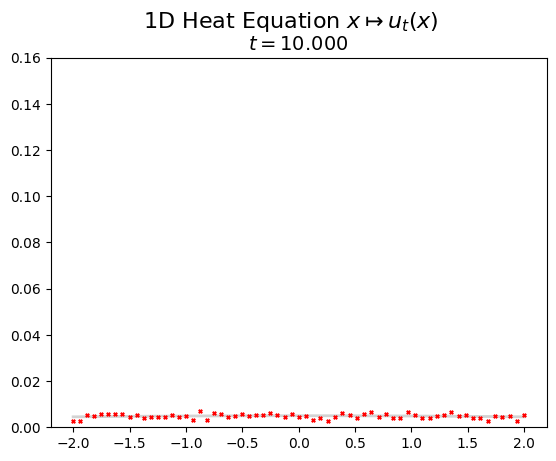

In [7]:
# Set up the figure and axis for the plot
fig, ax = plt.subplots()
line, = ax.plot(x_grid, G[0, :], linewidth=2, color='lightgrey', zorder=1)  # Initial plot
scatter = ax.scatter(sampled_x_grid[0, :], sampled_G_vals[0, :], color='red', s=6, marker='x')  # Initial scatter plot
ax.set_ylim(0, 0.16)  # Set the y-axis limits

fig.suptitle("1D Heat Equation $x \mapsto u_{t}(x)$", fontsize=16)
title = ax.set_title(f"$t = 0$", fontsize=14)

# re-define update function
def update(i):
    line.set_ydata(G[i, :])  # Update the y-data of the plot
    scatter.set_offsets(np.c_[sampled_x_grid[i, :], sampled_G_vals[i, :]])
    title.set_text(f"$t = {T_index[i]:.3f}$")
    return line,

# create the animation
ani = FuncAnimation(fig, update, frames=range(G.shape[0]), blit=True, interval=80)

# display
HTML(ani.to_jshtml())

# (1.5) Learn neural operator
Should be almost indistinguishable from training a conventional neurtal network.


Pick model (Fourier neural operator), optimizer (Adam), and hyperparameters (batch size and learning rate).
Moreover, define dataset, dataloader, and dataprocessor to run training of the neural operator.

In [8]:
# regression dataset
class RegressionDataset(Dataset):
    def __init__(self, x, y):
        
        # 1D to 2D
        x = np.repeat(x[:, np.newaxis, :], x.shape[1], axis=1)
        y = np.repeat(y[:, np.newaxis, :], y.shape[1], axis=1)
        
        # register
        self.x_data = torch.tensor(x, dtype=torch.float32)
        self.y_data = torch.tensor(y, dtype=torch.float32)
    
    def __len__(self):
        return len(self.x_data)
    
    def __getitem__(self, idx):
        # slightly unwieldy
        x = self.x_data[idx]
        y = self.y_data[idx]
        
        x = x.unsqueeze(0)
        y = y.unsqueeze(0)
        
        return {'x': x, 'y': y}

# device  
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    
# train dataset
train_dataset = RegressionDataset(x=sampled_x_grid,   y=sampled_G_vals)
eval_dataset  = RegressionDataset(x=samp_x_grid_eval, y=samp_G_vals_eval)

# Example: How to use the dataset with a DataLoader
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
eval_loader  = DataLoader(eval_dataset,  batch_size=32, shuffle=False)

# test
test_loaders = {16 : train_loader}

# data processor
_, _, data_processor = load_darcy_flow_small(n_train=1000, 
                                             batch_size=32,
                                             test_resolutions=[16,32], 
                                             n_tests=[100],
                                             test_batch_sizes=[32],
                                             positional_encoding=True)

# -> device
data_processor  = data_processor.to(device)

# neural operator model
model = FNO(n_modes=(16, 16), hidden_channels=64, in_channels=3, out_channels=1)

# -> device
model.to(device)

# optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=1E-3)

# scheduler
scheduler = scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=30)

# losses
l2loss = LpLoss(d=2, p=2)
h1loss = H1Loss(d=2)

# - attribute
train_loss = h1loss
eval_losses={'h1': h1loss, 'l2': l2loss}

# number of paras
n_params = count_model_params(model)
print(f'Neural Fourier operator: {n_params:,} parameters.')

Neural Fourier operator: 4,769,601 parameters.


## (1.6) Training of the neural operator

Define `Trainer` instance and run it. 

In [9]:
# number of epochs
n_epochs = 25

In [10]:
# create the trainer
trainer = neuralop.training.Trainer(model             = model, 
                                    n_epochs          = n_epochs,
                                    data_processor    = data_processor,
                                    wandb_log         = False,
                                    log_test_interval = 3,
                                    use_distributed   = False,
                                    verbose           = True)

self.override_load_to_device=False
self.overrides_loss=False


In [11]:
# train the model
trainer.train(train_loader  = train_loader,
              test_loaders  = test_loaders,
              optimizer     = optimizer,
              scheduler     = scheduler,
              regularizer   = False,
              training_loss = train_loss,
              eval_losses   = eval_losses)

{'16_h1': 0.07147324800491334, '16_l2': 0.029482752680778504}

## (1.7) Inference 
Zero-shot super-resolution for a more refined discretization. 

In [12]:
# super-resolution
data_processor.train = None
y_pred_superres_list = []
for i, batch in enumerate(eval_loader):
    proc_batch = data_processor.preprocess(batch)
    
    # inference
    y_pred = model(batch['x'])
    
    # post-process `y`
    output, data_dict = data_processor.postprocess(y_pred, proc_batch)
    
    # back-transformed output
    y_hat = data_dict['y']
    # -> CPU
    y_hat_cpu = y_hat.detach().cpu().numpy()
    
    # extract
    y_pred_superres_list.append(y_hat_cpu[:,0,0,:])
    
# stack predictions
y_pred_all = np.vstack(y_pred_superres_list)

# back-transform
mu_hat    = data_processor.out_normalizer.mean.item()
sigma_hat = data_processor.out_normalizer.std.item()

# de-normalize
y_pred_denorm_all = (y_pred_all - mu_hat) / sigma_hat

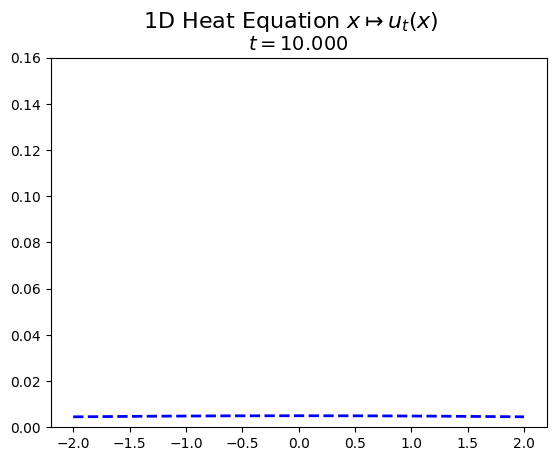

In [13]:
# Set up the figure and axis for the plot
fig, ax = plt.subplots()
line, = ax.plot(samp_x_grid_eval[0,:], y_pred_denorm_all[0, :], linewidth=2, color='blue', zorder=1, linestyle='--')  # Initial plot
#scatter = ax.scatter(sampled_x_grid[0, :], sampled_G_vals[0, :], color='red', s=6, marker='x', alpha=0.6)  # Initial scatter plot
ax.set_ylim(0, 0.16)  # Set the y-axis limits

fig.suptitle("1D Heat Equation $x \mapsto u_{t}(x)$", fontsize=16)
title = ax.set_title(f"$t = 0$", fontsize=14)

# yet again re-defined update function for the animation
def update(i):
    line.set_ydata(y_pred_denorm_all[i, :])
    #scatter.set_offsets(np.c_[sampled_x_grid[i, :], sampled_G_vals[i, :]])
    title.set_text(f"$t = {T_index[i]:.3f}$")
    return line, title

# Create the animation
ani = FuncAnimation(fig, update, frames=range(G.shape[0]), blit=True, interval=80)

# To display the animation in a Jupyter notebook, use the following:
HTML(ani.to_jshtml())

## (2.) Darcy Flow (elliptic)

Steady-state of Darcy Flow equation on unit box. 

$$
\begin{align*}
- \nabla \cdot ( a(x) \nabla u(x)) &= f(x) \qquad & x \in (0,1)^{2} \\
                          u(x) &= 0 \qquad  & x \in \partial (0,1)^{2}
\end{align*}
$$

In [14]:
# load model 
model = FNO(n_modes=(16, 16), hidden_channels=64, in_channels=3, out_channels=1)

# -> device
model = model.to(device)

# plot size
n_params = count_model_params(model)
print(f'FNO model instance has {n_params:,} parameters.')

FNO model instance has 4,769,601 parameters.


In [15]:
# INPUTS
n_epochs  = 20
b_size    = 32

In [16]:
# optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=8e-3, weight_decay=1e-4)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=30)

# scheduler
scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=30, gamma=0.1)

# loss
l2loss = LpLoss(d=2, p=2)
h1loss = H1Loss(d=2)

train_loss  = h1loss
eval_losses = {'h1': h1loss, 'l2': l2loss}

## (2.1) Training Setup
Dataloader, dataprocessor as before.

In [17]:
# data
train_loader, test_loaders, data_processor = load_darcy_flow_small(
    n_train=1000, 
    batch_size=b_size,
    test_resolutions=[16, 32], 
    n_tests=[100],
    test_batch_sizes=[32],
    positional_encoding=True)

# -> device
data_processor = data_processor.to(device)

In [18]:
# create the trainer
trainer = Trainer(model             = model, 
                  n_epochs          = n_epochs,
                  data_processor    = data_processor,
                  callbacks         = [BasicLoggerCallback()],
                  wandb_log         = False,
                  log_test_interval = 3,
                  use_distributed   = False,
                  verbose           = True)

using standard method to load data to device.
using standard method to compute loss.
self.override_load_to_device=False
self.overrides_loss=False


## (2.2) Run Training
This time a callback was added to trace progress.

In [19]:
# train the model
trainer.train(train_loader  = train_loader,
              test_loaders  = test_loaders,
              optimizer     = optimizer,
              scheduler     = scheduler,
              regularizer   = False,
              training_loss = train_loss,
              eval_losses   = eval_losses)

Training on 1000 samples
Testing on [50] samples         on resolutions [16].
Raw outputs of size out.shape=torch.Size([32, 1, 16, 16])
[0] time=0.28, avg_loss=33.5451, train_err=20.9657, 16_h1=0.4194, 16_l2=0.4167
[3] time=0.24, avg_loss=10.3823, train_err=6.4889, 16_h1=0.3693, 16_l2=0.3813
[6] time=0.24, avg_loss=7.0220, train_err=4.3888, 16_h1=0.2156, 16_l2=0.1995
[9] time=0.24, avg_loss=5.7877, train_err=3.6173, 16_h1=0.1931, 16_l2=0.1736
[12] time=0.24, avg_loss=5.6832, train_err=3.5520, 16_h1=0.1927, 16_l2=0.1727
[15] time=0.24, avg_loss=4.8495, train_err=3.0309, 16_h1=0.1846, 16_l2=0.1624
[18] time=0.24, avg_loss=4.6099, train_err=2.8812, 16_h1=0.1803, 16_l2=0.1561


{'16_h1': 0.1802855587005615, '16_l2': 0.15613040447235108}

## (2.3) Visual comparison
Given an input geology $x$, compares the flow field of the groundtruth and neural operator prediction.

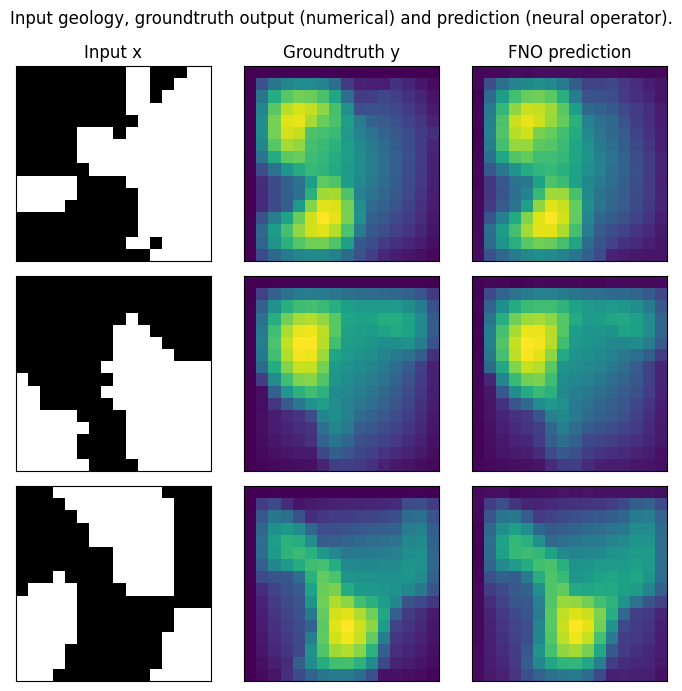

In [20]:
test_samples = test_loaders[16].dataset

fig = plt.figure(figsize=(7, 7))
for index in range(3):
    data = test_samples[index]
    data = data_processor.preprocess(data, batched=False)
    # Input x
    x = data['x']
    # Ground-truth
    y = data['y']
    # Model prediction
    out = model(x.unsqueeze(0))

    ax = fig.add_subplot(3, 3, index*3 + 1)
    ax.imshow(x[0].detach().cpu().numpy(), cmap='gray')
    if index == 0:
        ax.set_title('Input x')
    plt.xticks([], [])
    plt.yticks([], [])

    ax = fig.add_subplot(3, 3, index*3 + 2)
    ax.imshow(y.squeeze().detach().cpu().numpy())
    if index == 0:
        ax.set_title('Groundtruth y')
    plt.xticks([], [])
    plt.yticks([], [])

    ax = fig.add_subplot(3, 3, index*3 + 3)
    ax.imshow(out.squeeze().detach().cpu().numpy())
    if index == 0:
        ax.set_title('FNO prediction')
    plt.xticks([], [])
    plt.yticks([], [])

fig.suptitle('Input geology, groundtruth output (numerical) and prediction (neural operator).', y=0.98)
plt.tight_layout()
fig.show()

## (2.4) Homework: Solve inverse problem 
Problem setting is outlined in this fanatastic JUpyter notebook.
[The notebook](https://github.com/Zhengyu-Huang/InverseProblems.jl/blob/master/Fluid/Darcy-2D.ipynb)

Contemplate how to leverage a neural operator (with or without `neuralop` library) in this setting.
Optional: Write an email to us to brag about your results. 